# Experiment # 3. - UMAP as pre- and post-processing step.

**Semi-Supervised Learning with UMAP**:
- Apply Uniform Manifold Approximation and Projection (UMAP) for DR on node features before and after training a semi-supervised GNN model.
- Evaluate the model on a more complex dataset like Citeseer, focusing on the impact of DR on label propagation and the learning of node representations.

Import section:

In [20]:
import torch
import torch.nn.functional as F
from torch_geometric.datasets import Planetoid
from torch_geometric.nn import GCNConv
from umap import UMAP
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import warnings
from utils import *

random_state = 0
random.seed(0)
torch.manual_seed(0)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
warnings.filterwarnings('ignore', message="n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.")
warnings.filterwarnings('ignore', message="Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.")
warnings.filterwarnings('ignore', message="Graph is not fully connected, spectral embedding may not work as expected.")
print("Is cuda available?", torch.cuda.is_available())

Is cuda available? True


## 1. Training the model on original features

Loading the CiteSeer dataset:

In [21]:
dataset = Planetoid(root='.', name='CiteSeer')
data = dataset[0].to(device) # Move data to GPU

# prepare variables for further UMAP experiments
data_x_cpu = dataset[0].x.cpu().detach().numpy()
data_y_cpu = dataset[0].y.cpu().numpy()

Defining the GCN model and optimizer:

In [3]:
model = GCN(input_dim=dataset.num_node_features, hidden_dim=64, output_dim=dataset.num_classes).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

Training loop and model evaluation:

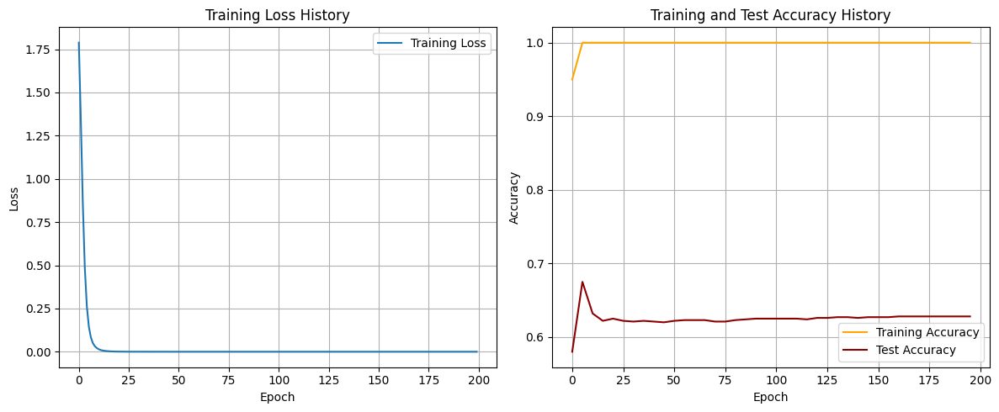

Accuracy: 0.6280, Precision: 0.6132, Recall: 0.6034, F1 Score: 0.5988


In [4]:
n_epochs = 200
loss_history, train_acc_history, test_acc_history = train_loop(n_epochs, model, optimizer, data)

plot_training_history(loss_history, train_acc_history, test_acc_history, grid=True)
   
accuracy, precision, recall, f1 = evaluate_model(model, data)
print(f"Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")

Model seems to be overfitting quite heavily. Let's try to improve the results by fine-tuning.

### 1.1 Model selection

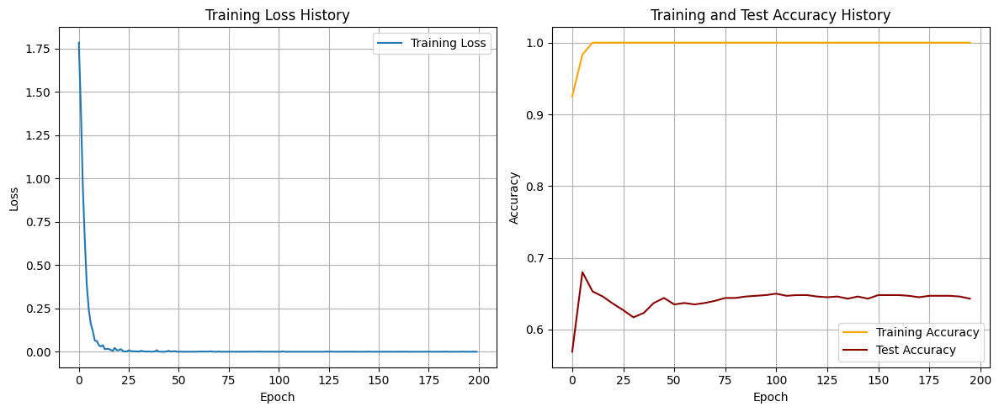

Dropout rate: 0.5, Accuracy: 0.6450, Precision: 0.6272, Recall: 0.6185, F1 Score: 0.6178


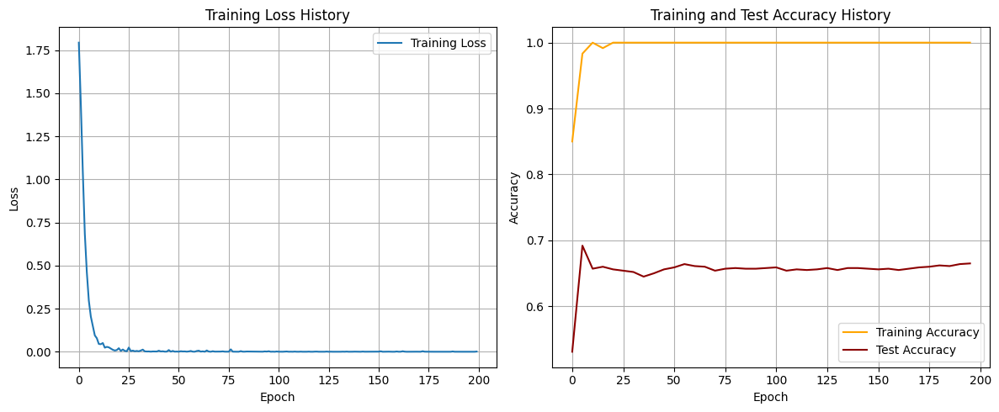

Dropout rate: 0.6, Accuracy: 0.6660, Precision: 0.6345, Recall: 0.6349, F1 Score: 0.6318


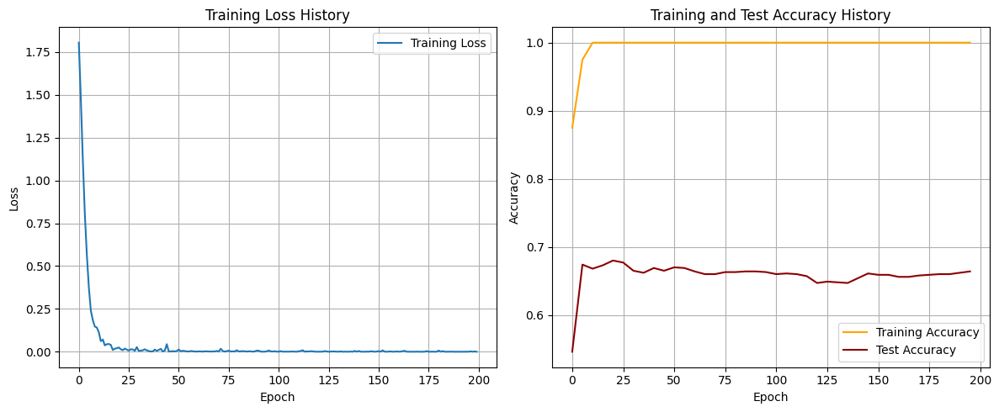

Dropout rate: 0.7, Accuracy: 0.6670, Precision: 0.6389, Recall: 0.6406, F1 Score: 0.6361


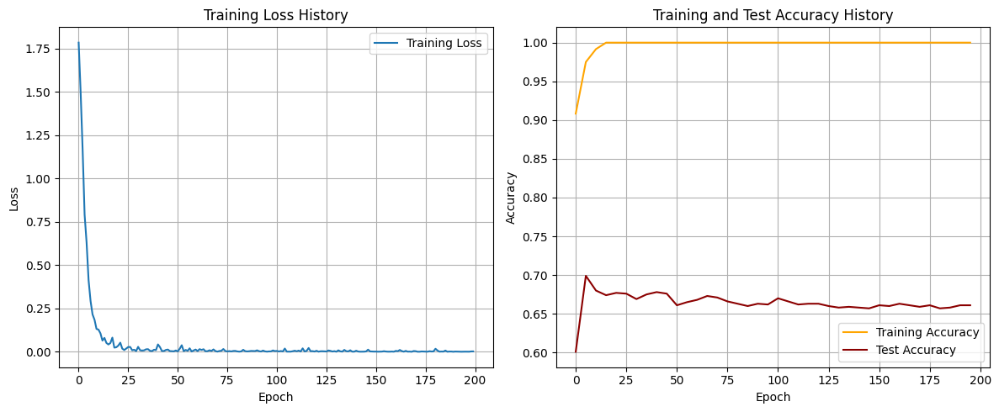

Dropout rate: 0.75, Accuracy: 0.6580, Precision: 0.6296, Recall: 0.6278, F1 Score: 0.6231


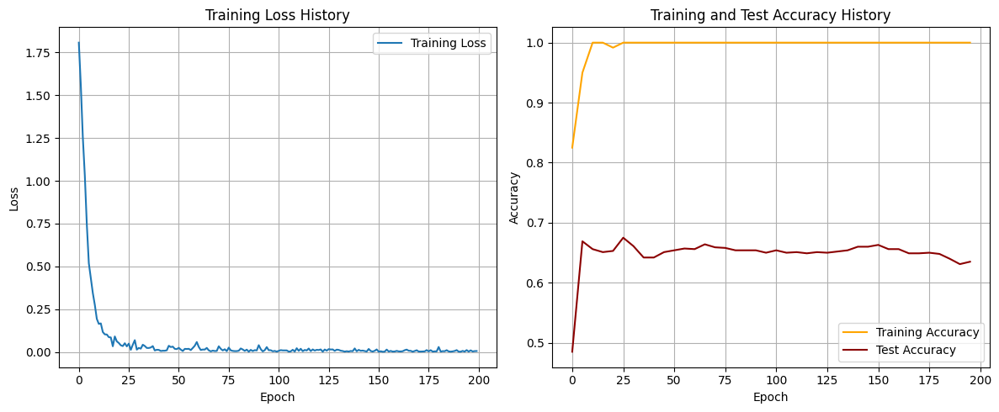

Dropout rate: 0.8, Accuracy: 0.6450, Precision: 0.6236, Recall: 0.6174, F1 Score: 0.6160


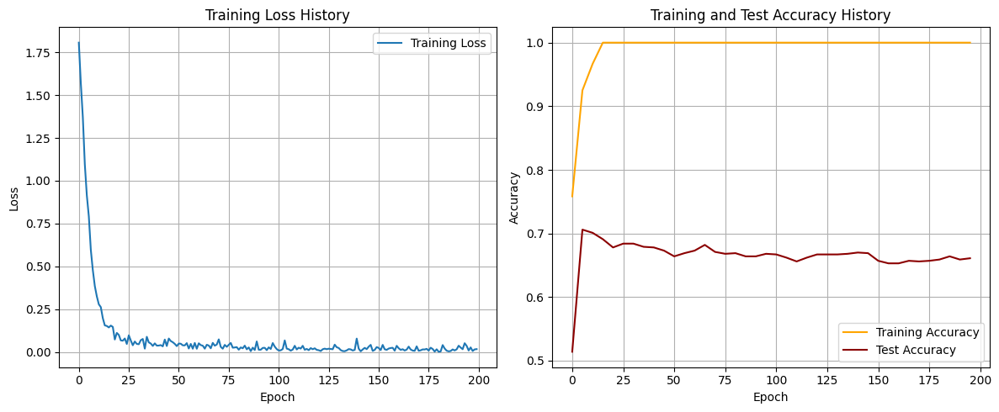

Dropout rate: 0.85, Accuracy: 0.6610, Precision: 0.6347, Recall: 0.6354, F1 Score: 0.6318


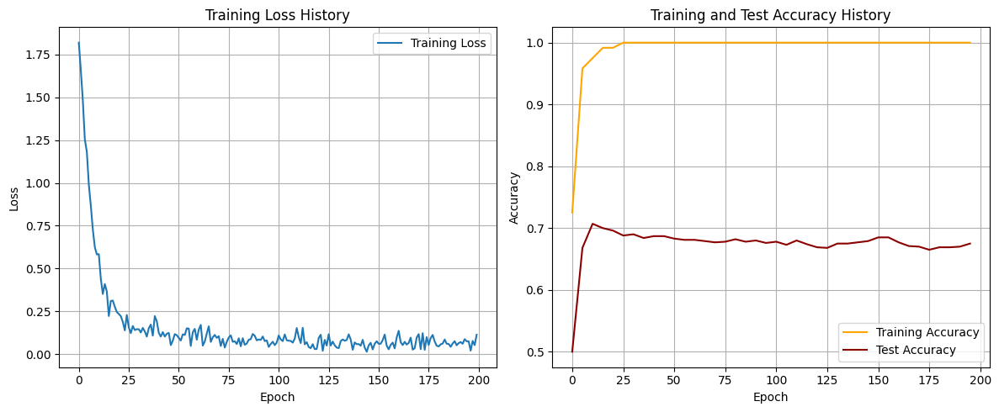

Dropout rate: 0.9, Accuracy: 0.6770, Precision: 0.6433, Recall: 0.6457, F1 Score: 0.6423


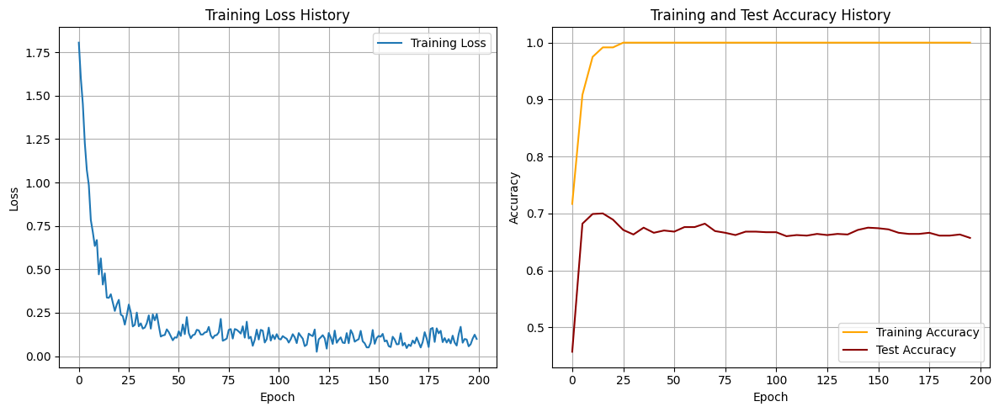

Dropout rate: 0.91, Accuracy: 0.6590, Precision: 0.6392, Recall: 0.6342, F1 Score: 0.6304


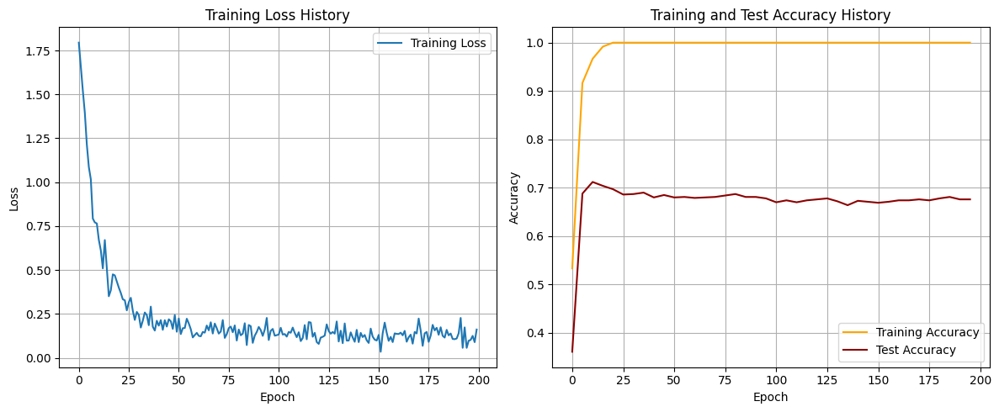

Dropout rate: 0.92, Accuracy: 0.6700, Precision: 0.6447, Recall: 0.6457, F1 Score: 0.6409


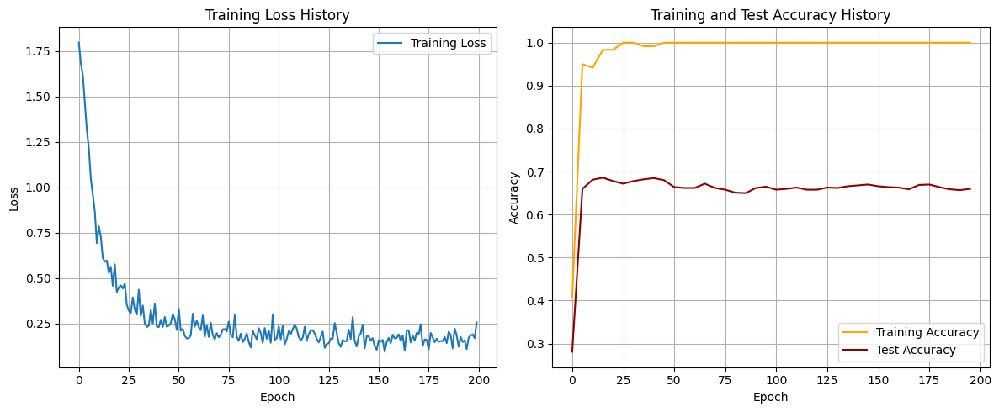

Dropout rate: 0.93, Accuracy: 0.6570, Precision: 0.6399, Recall: 0.6383, F1 Score: 0.6313


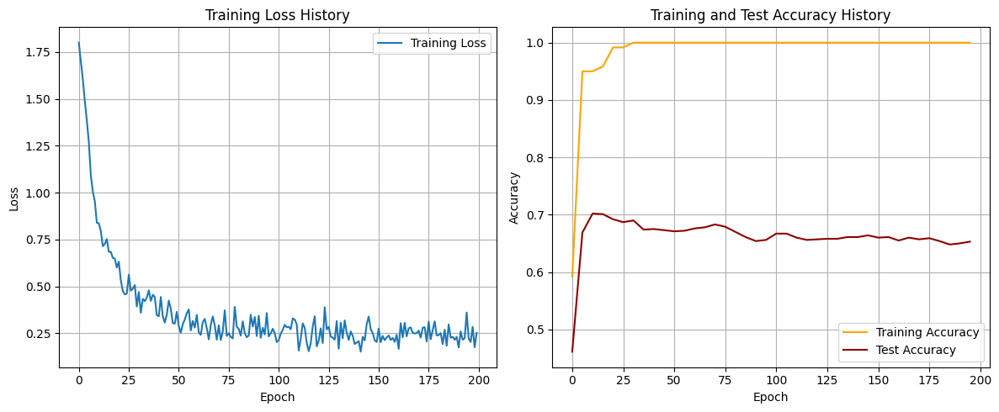

Dropout rate: 0.94, Accuracy: 0.6510, Precision: 0.6374, Recall: 0.6283, F1 Score: 0.6259


In [5]:
for dr in [0.5, 0.6, 0.7, 0.75, 0.8, 0.85, 0.9, 0.91, 0.92, 0.93, 0.94]:

    model = GCN_with_dropout(input_dim=dataset.num_node_features, hidden_dim=64, output_dim=dataset.num_classes, dropout_rate=dr).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
    
    n_epochs = 200
    loss_history, train_acc_history, test_acc_history = train_loop(n_epochs, model, optimizer, data)
    plot_training_history(loss_history, train_acc_history, test_acc_history, grid=True)
       
    accuracy, precision, recall, f1 = evaluate_model(model, data)
    print(f"Dropout rate: {dr}, Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")

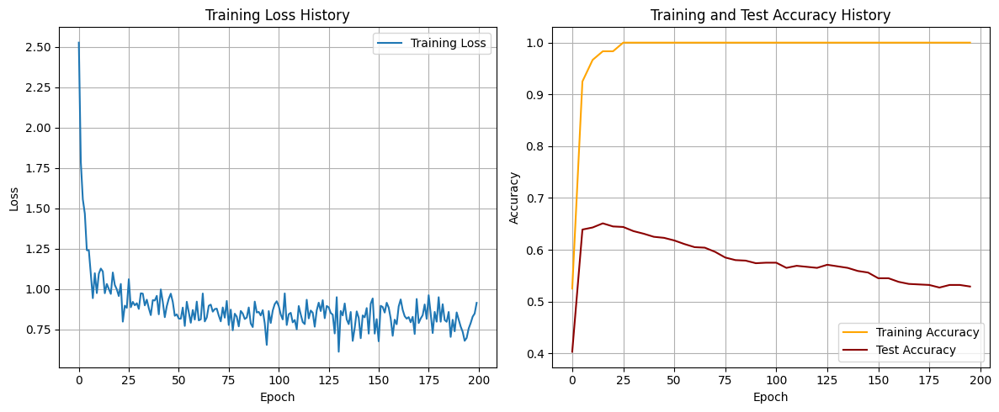

Dropout rate: 0.6, Accuracy: 0.5310, Precision: 0.5369, Recall: 0.5165, F1 Score: 0.5160


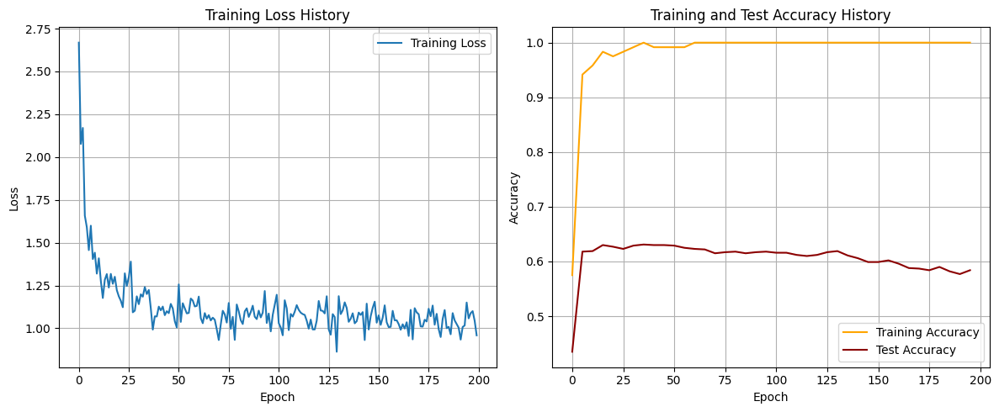

Dropout rate: 0.7, Accuracy: 0.5850, Precision: 0.5779, Recall: 0.5642, F1 Score: 0.5635


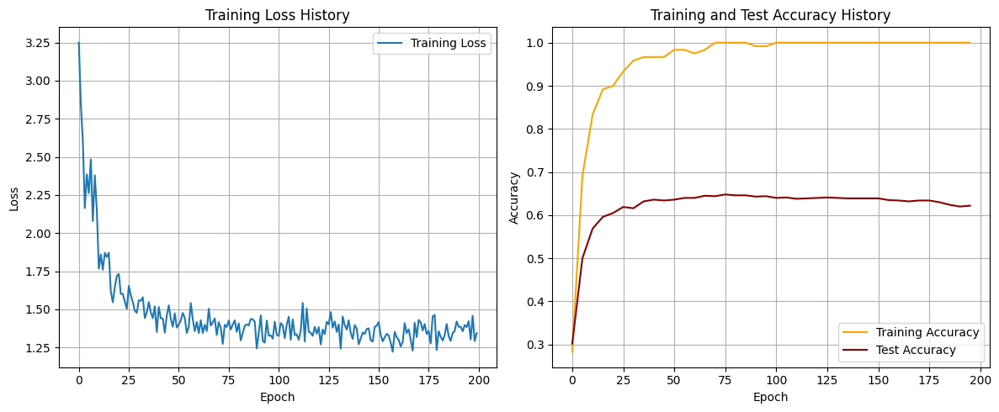

Dropout rate: 0.8, Accuracy: 0.6210, Precision: 0.6085, Recall: 0.6055, F1 Score: 0.6009


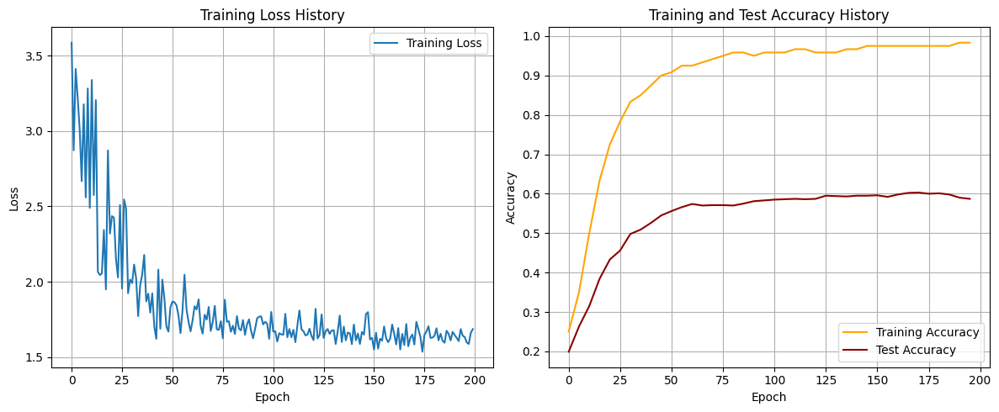

Dropout rate: 0.9, Accuracy: 0.5850, Precision: 0.5885, Recall: 0.5719, F1 Score: 0.5660


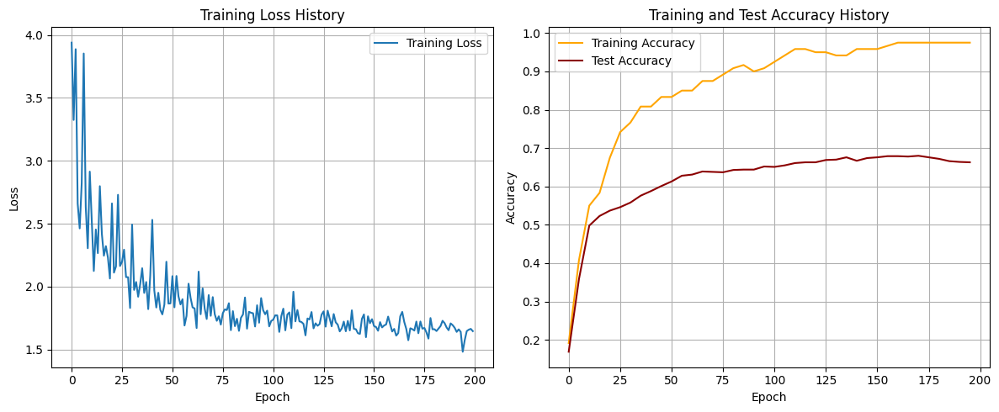

Dropout rate: 0.91, Accuracy: 0.6650, Precision: 0.6357, Recall: 0.6306, F1 Score: 0.6285


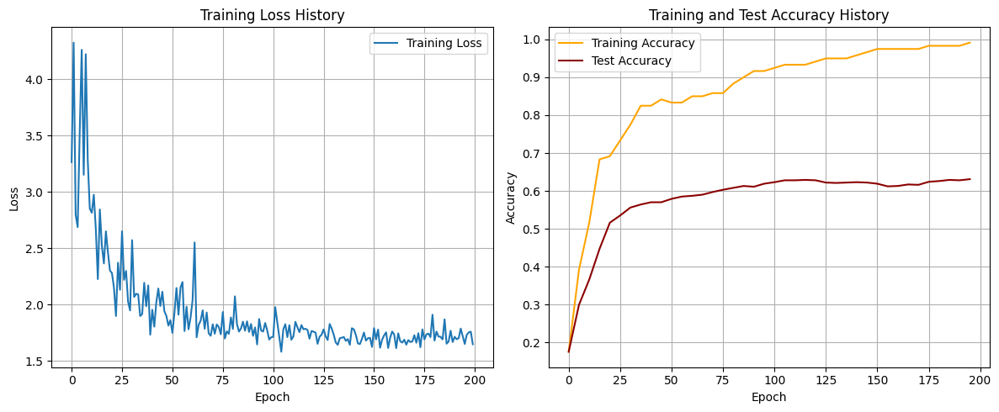

Dropout rate: 0.92, Accuracy: 0.6310, Precision: 0.6033, Recall: 0.6097, F1 Score: 0.6004


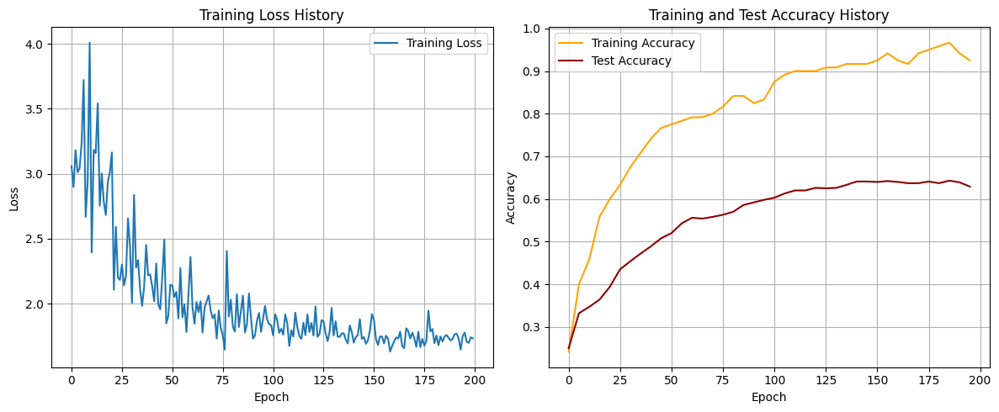

Dropout rate: 0.93, Accuracy: 0.6340, Precision: 0.6224, Recall: 0.6117, F1 Score: 0.6004


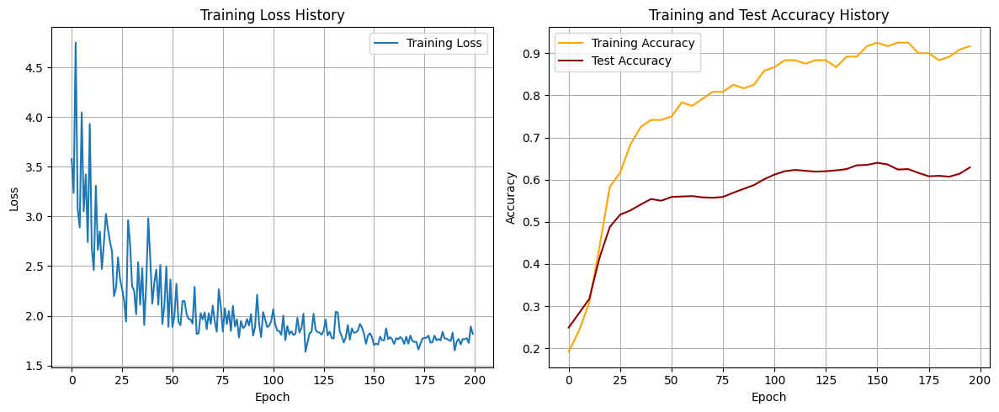

Dropout rate: 0.94, Accuracy: 0.6430, Precision: 0.6192, Recall: 0.6101, F1 Score: 0.6034


In [6]:
for dr in [0.6, 0.7, 0.8, 0.9, 0.91, 0.92, 0.93, 0.94]:
    model = GCN_with_dropout_and_bn(input_dim=dataset.num_node_features, hidden_dim=64, output_dim=dataset.num_classes, dropout_rate=dr).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
    
    n_epochs = 200
    loss_history, train_acc_history, test_acc_history = train_loop(n_epochs, model, optimizer, data)
    
    plot_training_history(loss_history, train_acc_history, test_acc_history, grid=True)
       
    accuracy, precision, recall, f1 = evaluate_model(model, data)
    print(f"Dropout rate: {dr}, Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")

After carefull examination of the above results, I decided to move forward with model with only dropout layers (without batch normaization) with dropout rate = 0.9. This conclusion comes from the balance between accuracy, precision, recall, F1 score, training loss and the history of the training.

### 1.2 Model evaluation

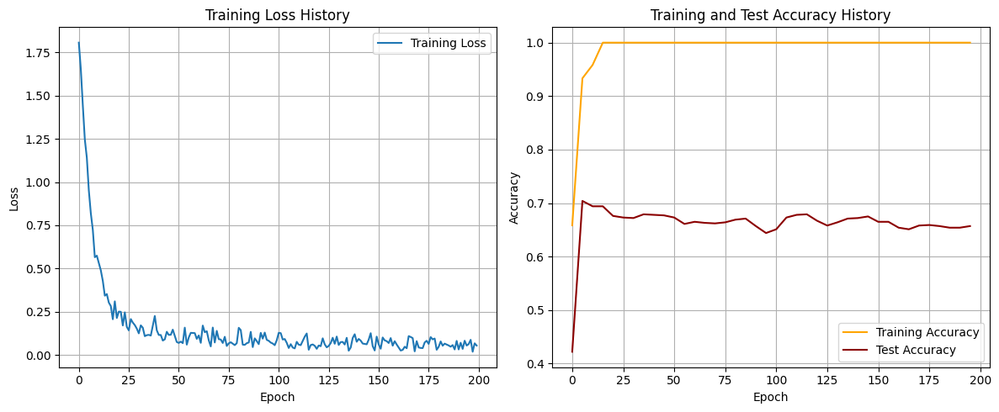

Accuracy: 0.6570, Precision: 0.6419, Recall: 0.6363, F1 Score: 0.6329


In [22]:
model = GCN_with_dropout(input_dim=dataset.num_node_features, hidden_dim=64, output_dim=dataset.num_classes, dropout_rate=0.9).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

n_epochs = 200
loss_history, train_acc_history, test_acc_history = train_loop(n_epochs, model, optimizer, data)

plot_training_history(loss_history, train_acc_history, test_acc_history, grid=True)
   
accuracy, precision, recall, f1 = evaluate_model(model, data)
print(f"Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")

## 2. UMAP as post-processing step
In this section the UMAP visualisation is prepared using the output of the model trained on original features.

### 2.1 Default UMAP

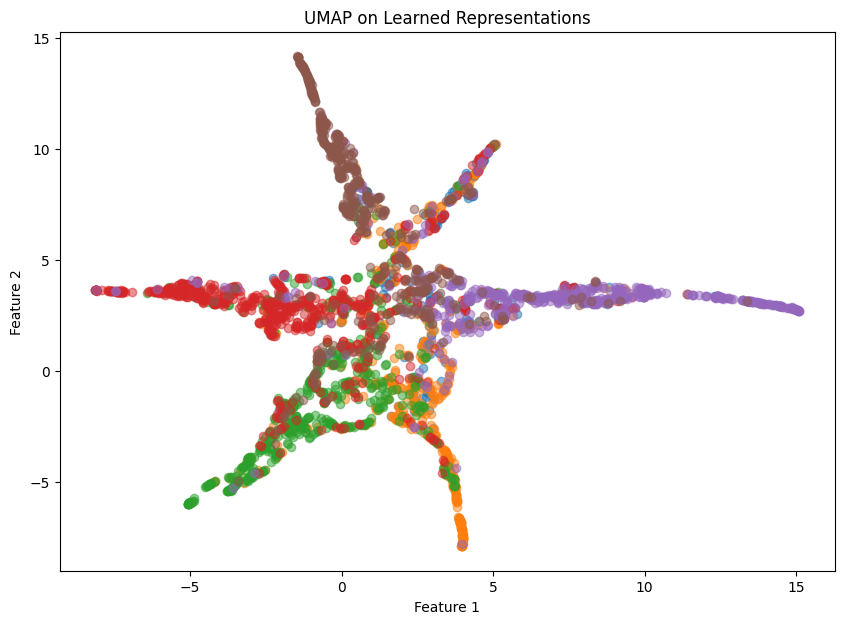

In [23]:
# Extract node representations
model.eval()
with torch.no_grad():
    embeddings = model(data)

embeddings = embeddings.cpu().numpy()

# Apply UMAP on Learned Node Representations
umap_post = UMAP(n_components=2, random_state=0)
embeddings_umap_post = umap_post.fit_transform(embeddings)

visualise(embeddings_umap_post, data_y_cpu, 'UMAP on Learned Representations')

### 2.2 Fine-tuning UMAP

#### 2.2.1 metric vs min_dist vs n_neighbors

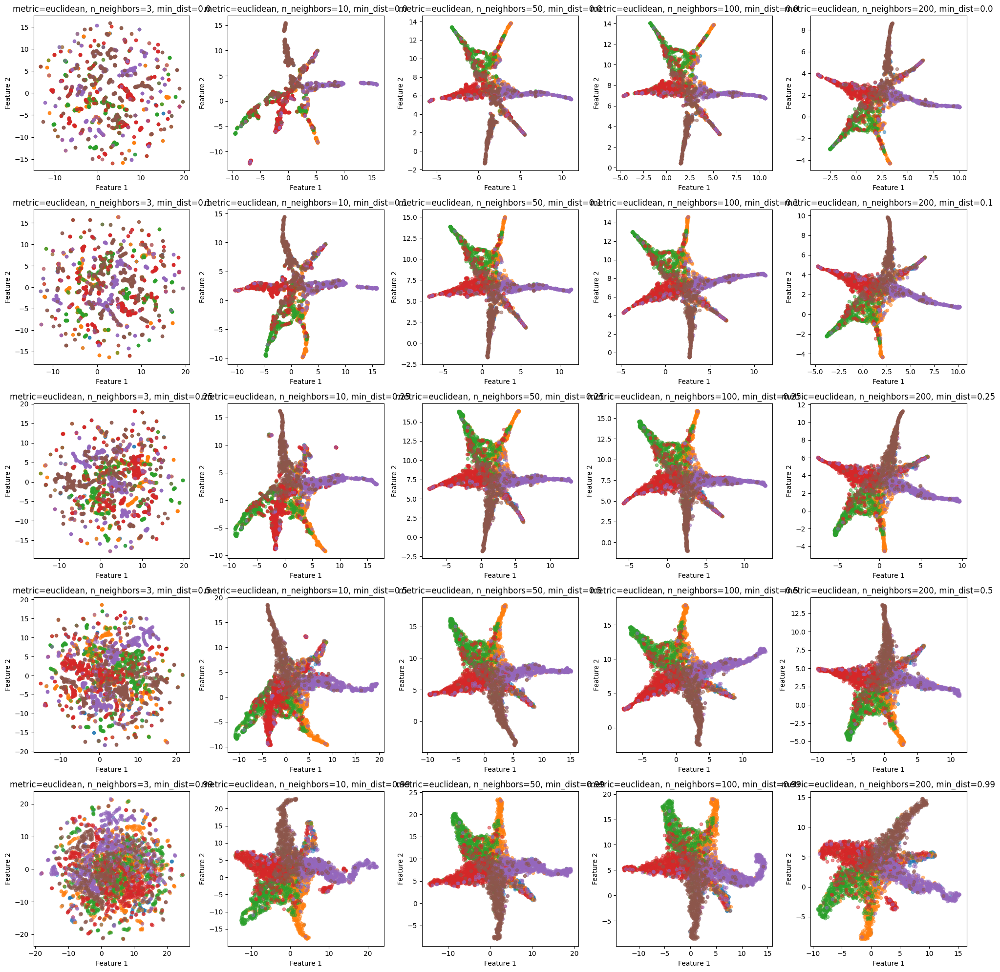

/home/asemerjak/.local/lib/python3.10/site-packages/sklearn/manifold/_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/home/asemerjak/.local/lib/python3.10/site-packages/sklearn/manifold/_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/home/asemerjak/.local/lib/python3.10/site-packages/sklearn/manifold/_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/home/asemerjak/.local/lib/python3.10/site-packages/sklearn/manifold/_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/home/asemerjak/.local/lib/python3.10/site-packages/sklearn/manifold/_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warni

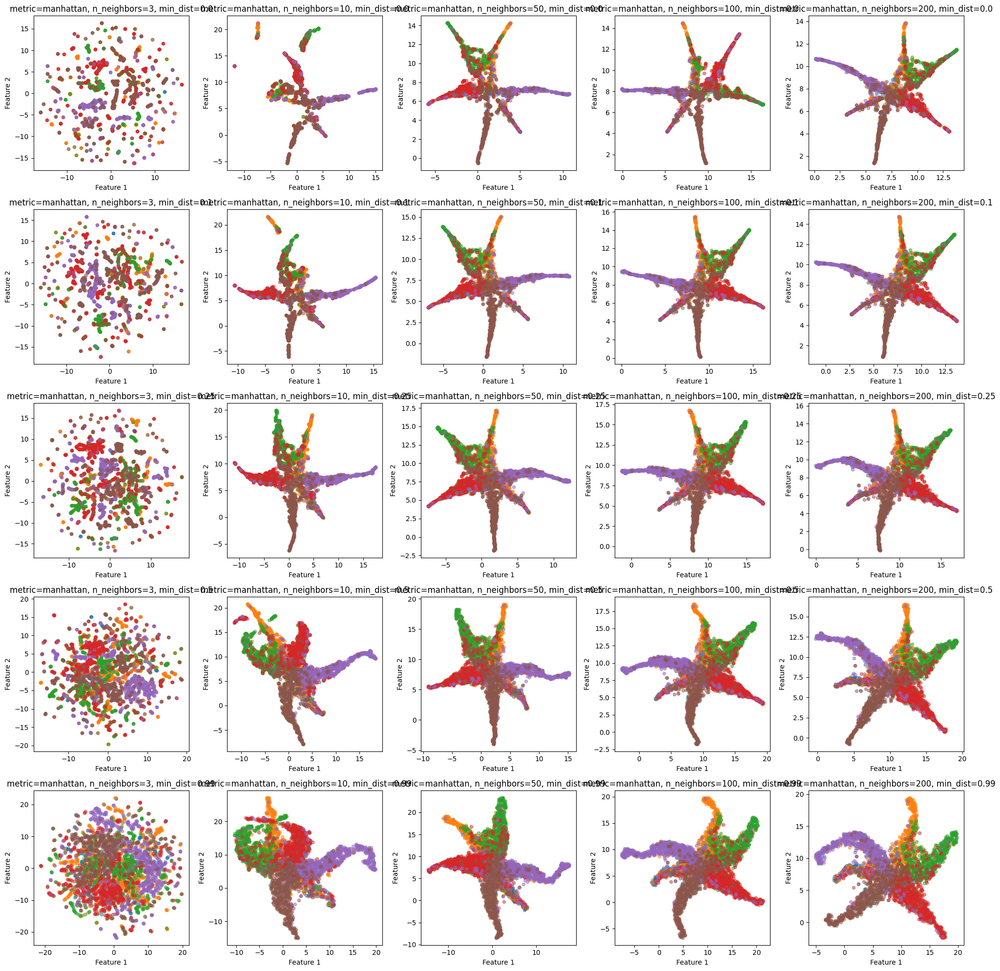

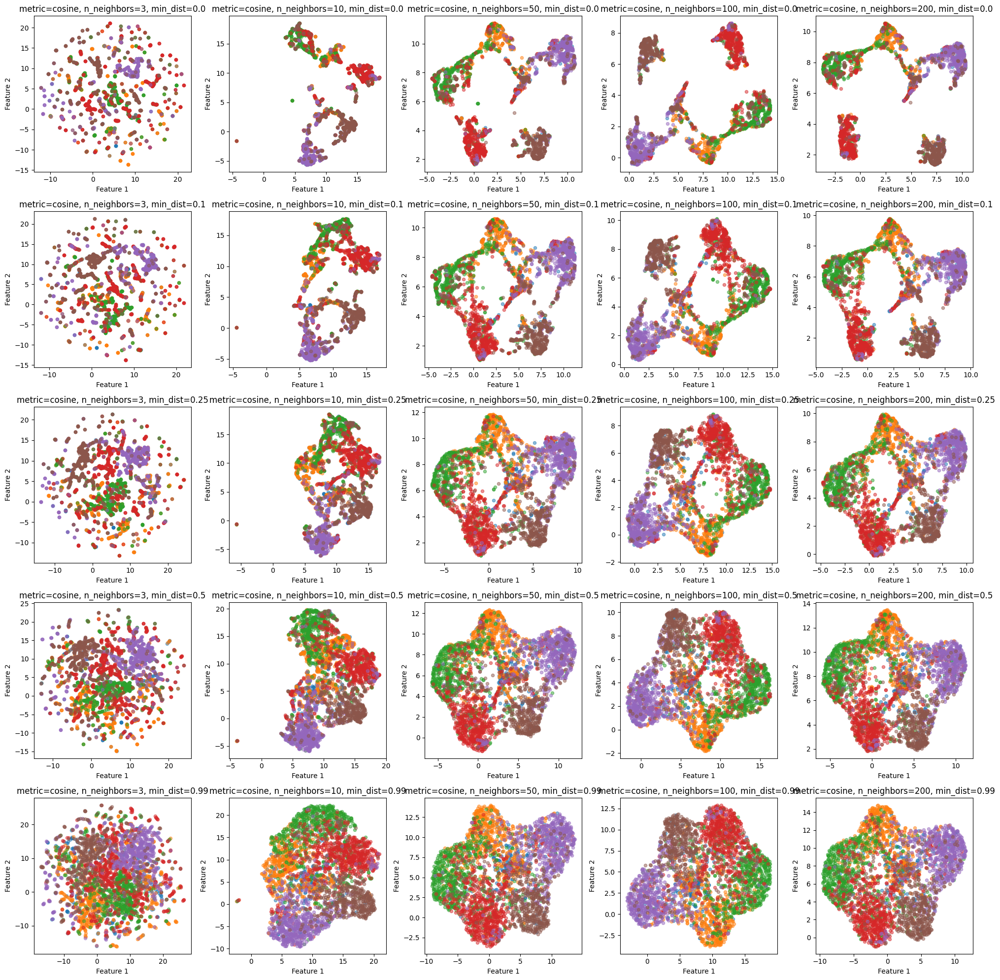

In [9]:
for metric in ['euclidean', 'manhattan', 'cosine']:
    fig, axs = plt.subplots(5, 5, figsize=(20, 20)) 
    axs = axs.flatten()
    i = 0
    for min_dist in [0.0, 0.1, 0.25, 0.5, 0.99]:
        for n_neighbors in [3, 10, 50, 100, 200]:
        
            umap_post = UMAP(n_components=2, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
            umap_results = umap_post.fit_transform(embeddings)
    
            plot_no_show(axs[i], umap_results, data_y_cpu, f'metric={metric}, n_neighbors={n_neighbors}, min_dist={min_dist}', size=20)

            i += 1


    plt.tight_layout()
    plt.show()

The best metric seems to be **cosine**. Let's discard n_neighbors=3 and min_dist=0 and investigate further.

#### 2.2.2 min_dist vs n_neighbors using cosine metric

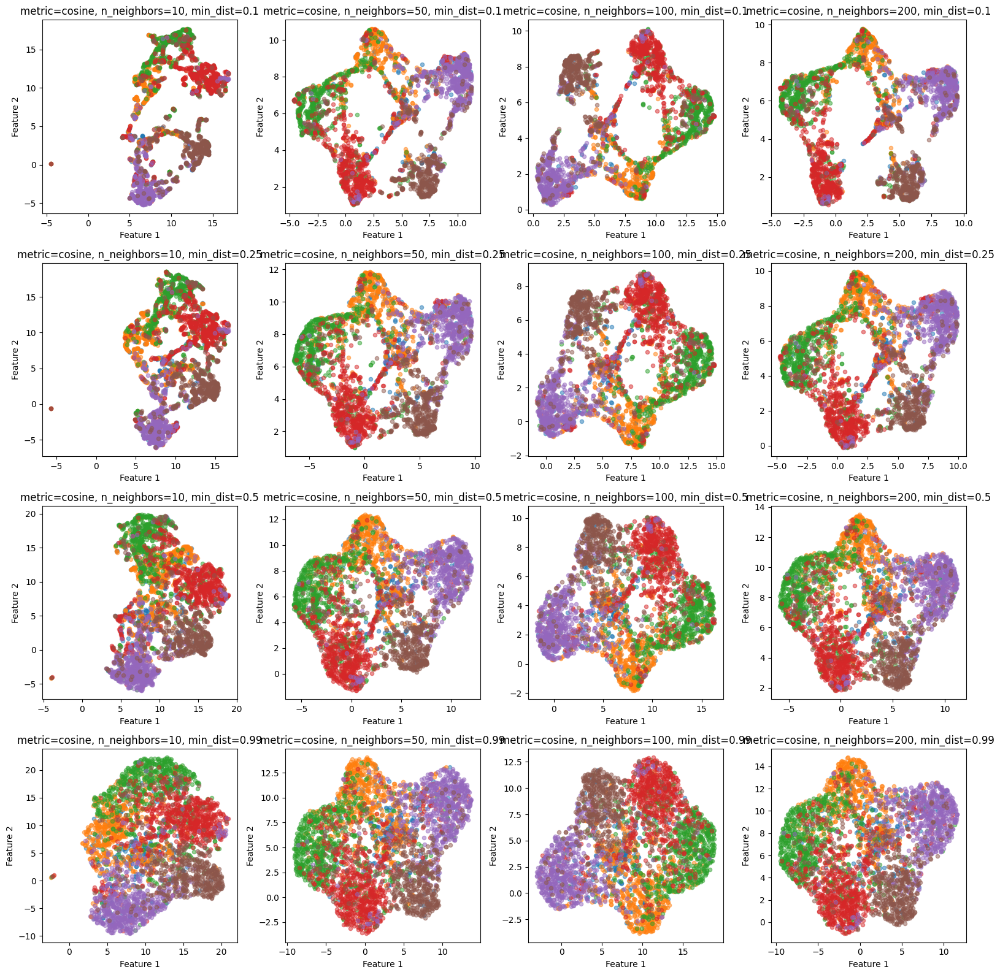

In [10]:
metric = 'cosine'
fig, axs = plt.subplots(4, 4, figsize=(16, 16)) 
axs = axs.flatten()
i = 0
for min_dist in [0.1, 0.25, 0.5, 0.99]:
    for n_neighbors in [10, 50, 100, 200]:
    
        umap_post = UMAP(n_components=2, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
        umap_results = umap_post.fit_transform(embeddings)

        plot_no_show(axs[i], umap_results, data_y_cpu, f'metric={metric}, n_neighbors={n_neighbors}, min_dist={min_dist}', size=20)

        i += 1

plt.tight_layout()
plt.show()

**n_neighbors=50** seems to be the best paramater value and will be used from now on.

#### 2.2.3 min_dist impact investigation

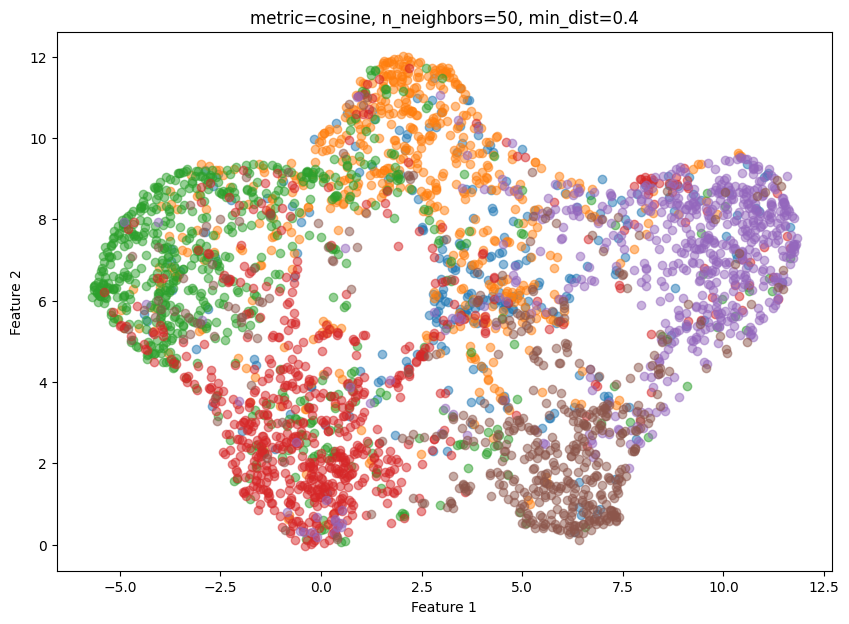

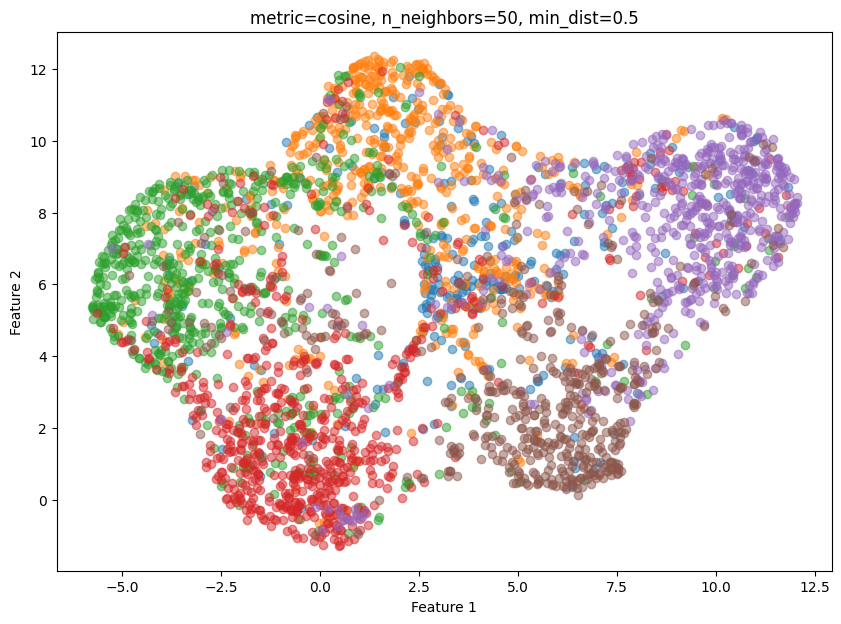

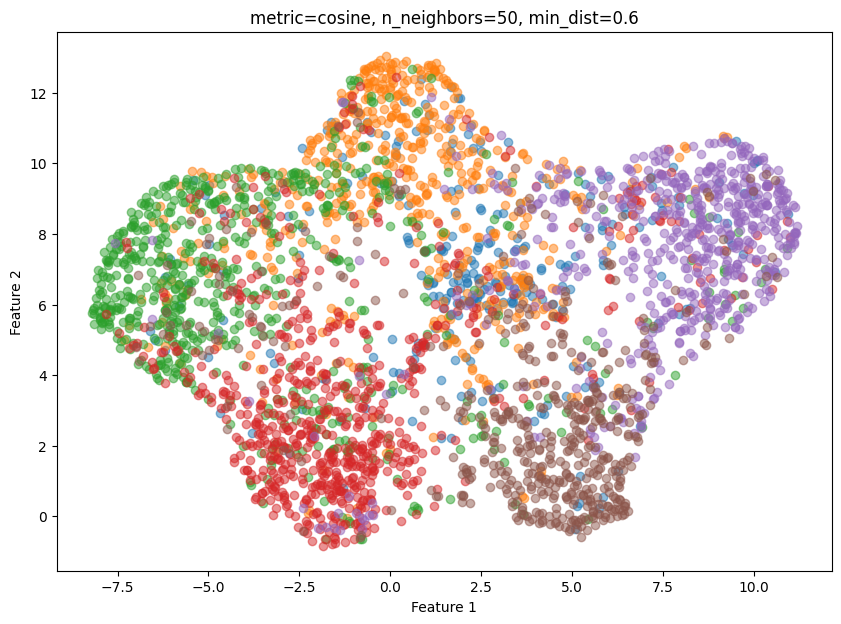

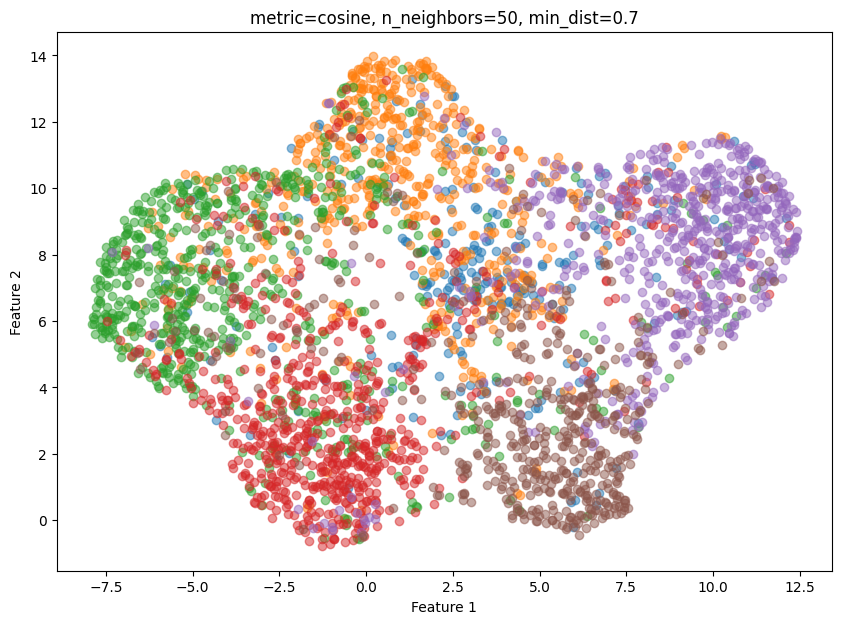

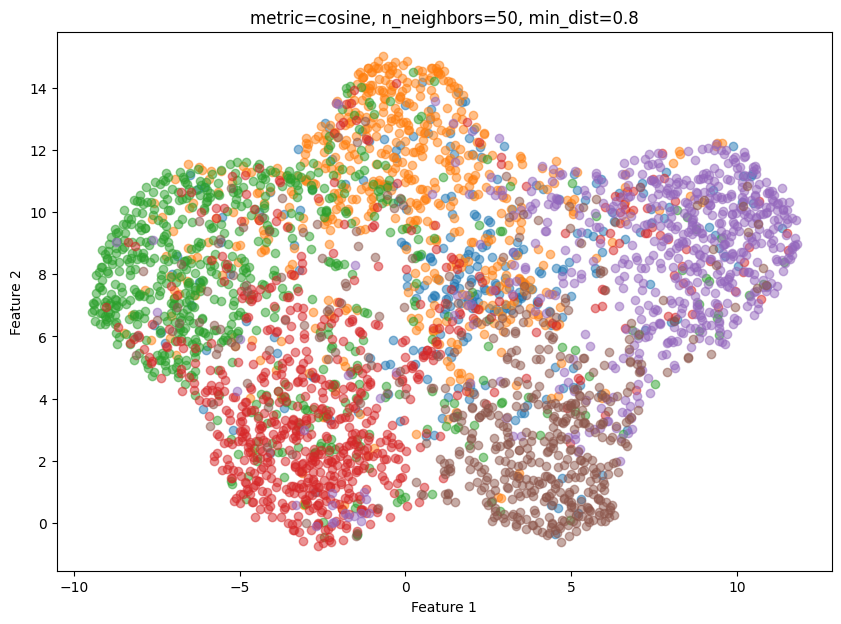

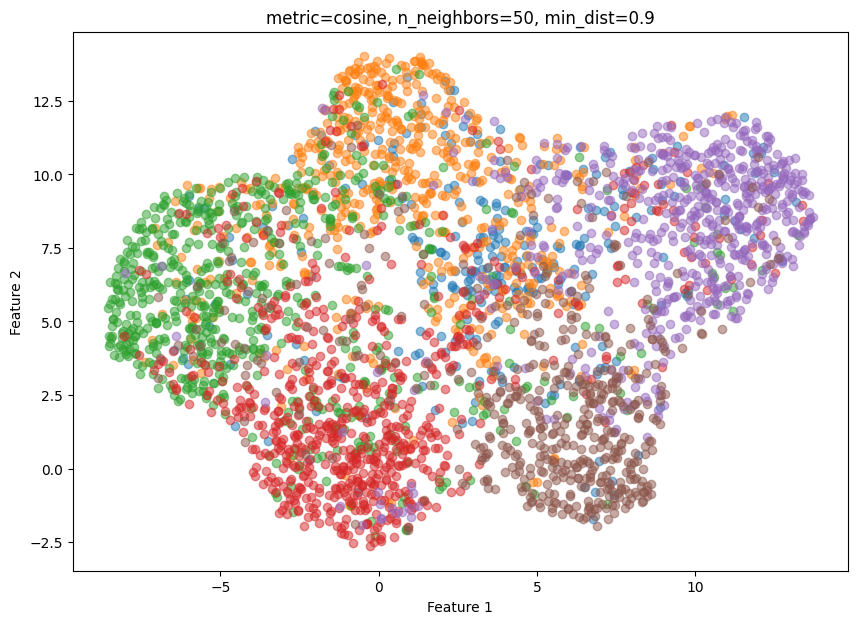

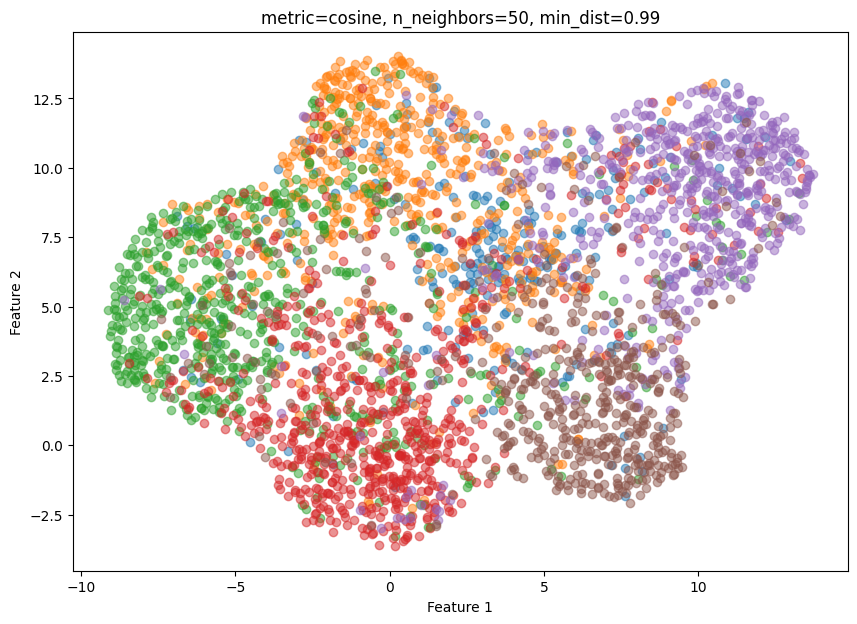

In [13]:
metric='cosine'
n_neighbors=50
for min_dist in [0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]:
    umap_post = UMAP(n_components=2, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
    umap_results = umap_post.fit_transform(embeddings)
    
    visualise(umap_results, data_y_cpu, f'metric={metric}, n_neighbors={n_neighbors}, min_dist={min_dist}')

**min_dist=0.5** gives the best results.

### 2.3 Fine-tuned UMAP vs default UMAP

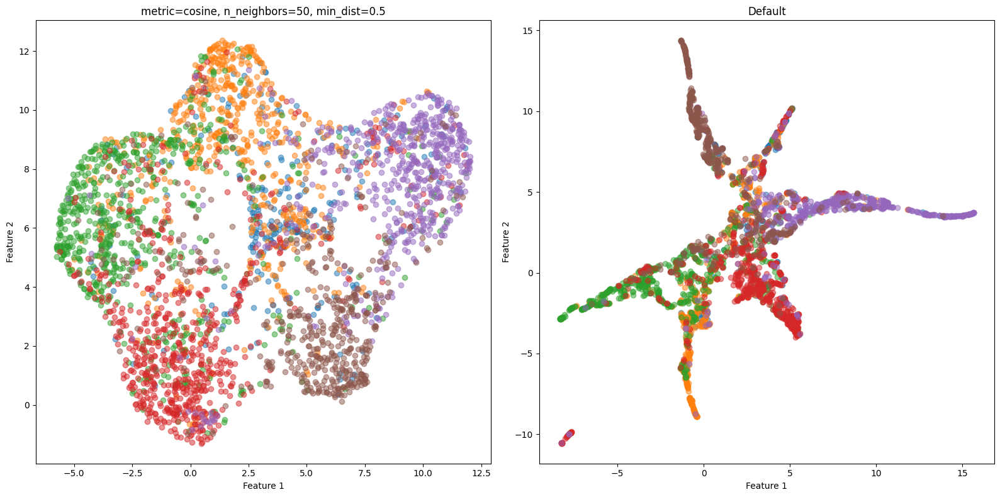

In [16]:
fig, axs = plt.subplots(1, 2, figsize=(16, 8)) 

metric='cosine'
n_neighbors=50
min_dist=0.5

umap_post = UMAP(n_components=2, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
umap_results = umap_post.fit_transform(embeddings)

plot_no_show(axs[0], umap_results, data_y_cpu, f'metric={metric}, n_neighbors={n_neighbors}, min_dist={min_dist}')

umap_post = UMAP(n_components=2, random_state=0)
umap_results = umap_post.fit_transform(embeddings)

plot_no_show(axs[1], umap_results, data_y_cpu, f'Default')

plt.tight_layout()
plt.show()

## 3. UMAP as pre-processing step

### 3.1 n_components vs evaluation metrics

In [8]:
# Range of UMAP components to explore
components_range = [2, 50, 100, 300, 500]
n_epochs=200

metrics_results = {'accuracy': [], 'precision': [], 'recall': [], 'f1': []}

for n_components in components_range:
    # Preprocess features
    reducer = UMAP(n_components=n_components, random_state=0)
    processed_features = reducer.fit_transform(data_x_cpu)
    data.x = torch.tensor(processed_features, dtype=torch.float)
    data = data.to(device)
    
    model = GCN_with_dropout(input_dim=n_components, hidden_dim=64, output_dim=dataset.num_classes, dropout_rate=0.9).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

    train_loop(n_epochs, model, optimizer, data, acc_freq=-1)  
    accuracy, precision, recall, f1 = evaluate_model(model, data)
          
    metrics_results['accuracy'].append(accuracy)
    metrics_results['precision'].append(precision)
    metrics_results['recall'].append(recall)
    metrics_results['f1'].append(f1)

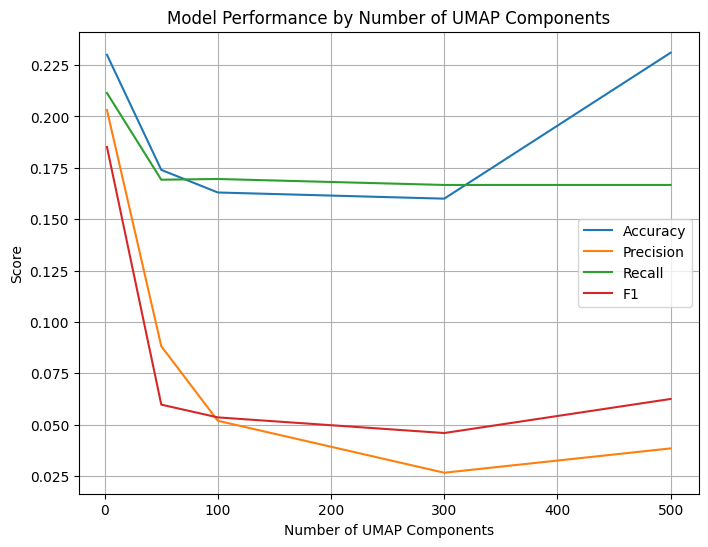

In [9]:
plt.figure(figsize=(8, 6))

for metric in metrics_results:
    plt.plot(components_range, metrics_results[metric], label=metric.capitalize())

plt.xlabel('Number of UMAP Components')
plt.ylabel('Score')
plt.title('Model Performance by Number of UMAP Components')
plt.legend()
plt.grid(True)
plt.show()


The results are extremely poor. Let's investigate if manipulating model parameters will improve the outcome.

### 3.2 hidden_dim vs n_components vs visualisation metrics

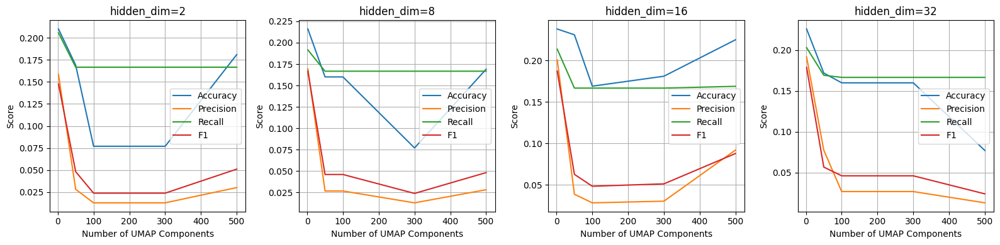

In [13]:
fig, axs = plt.subplots(1, 4, figsize=(16, 4)) 
axs = axs.flatten()
i = 0

components_range = [2, 50, 100, 300, 500]
for hidden_dim in [2, 8, 16, 32]:
    metrics_results = {'accuracy': [], 'precision': [], 'recall': [], 'f1': []}
    
    for n_components in components_range:
        # Preprocess features
        reducer = UMAP(n_components=n_components, random_state=0)
        processed_features = reducer.fit_transform(data_x_cpu)
        data.x = torch.tensor(processed_features, dtype=torch.float)
        data = data.to(device)
        
        model = GCN_with_dropout(input_dim=n_components, hidden_dim=hidden_dim, output_dim=dataset.num_classes, dropout_rate=0.9).to(device)
        optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
    
        train_loop(n_epochs, model, optimizer, data, acc_freq=-1)
        accuracy, precision, recall, f1 = evaluate_model(model, data)
              
        metrics_results['accuracy'].append(accuracy)
        metrics_results['precision'].append(precision)
        metrics_results['recall'].append(recall)
        metrics_results['f1'].append(f1)
    
    
    for metric in metrics_results:
        axs[i].plot(components_range, metrics_results[metric], label=metric.capitalize())
    
    axs[i].set_xlabel('Number of UMAP Components')
    axs[i].set_ylabel('Score')
    axs[i].set_title(f'hidden_dim={hidden_dim}')
    axs[i].legend()
    axs[i].grid(True)

    i += 1
plt.tight_layout()
plt.show()

Manipulating the number of hidden dimensions does not improve the model performane for any number of components.

### 3.3 n_epochs vs n_components vs evaluation metrics

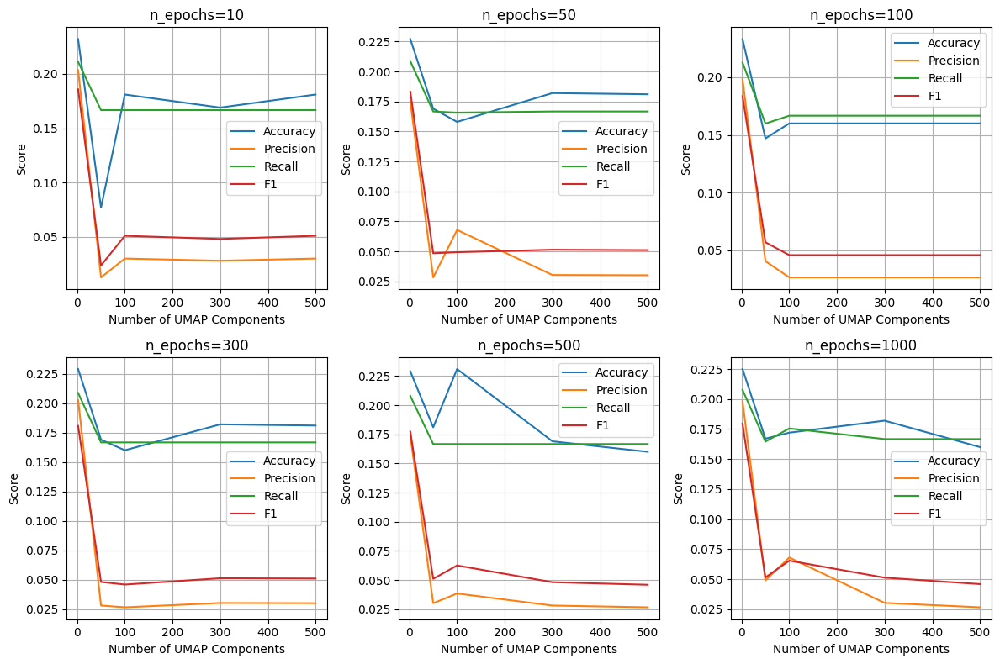

In [16]:
fig, axs = plt.subplots(2, 3, figsize=(12, 8)) 
axs = axs.flatten()
i = 0
hidden_dim=64
components_range = [2, 50, 100, 300, 500]
for n_epochs in [10, 50, 100, 300, 500, 1000]:
    metrics_results = {'accuracy': [], 'precision': [], 'recall': [], 'f1': []}
    
    for n_components in components_range:
        # Preprocess features
        reducer = UMAP(n_components=n_components, random_state=0)
        processed_features = reducer.fit_transform(data_x_cpu)
        data.x = torch.tensor(processed_features, dtype=torch.float)
        data = data.to(device)
        
        model = GCN_with_dropout(input_dim=n_components, hidden_dim=hidden_dim, output_dim=dataset.num_classes, dropout_rate=0.9).to(device)
        optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
    
        train_loop(n_epochs, model, optimizer, data, acc_freq=-1)
        accuracy, precision, recall, f1 = evaluate_model(model, data)
              
        metrics_results['accuracy'].append(accuracy)
        metrics_results['precision'].append(precision)
        metrics_results['recall'].append(recall)
        metrics_results['f1'].append(f1)
    
    
    for metric in metrics_results:
        axs[i].plot(components_range, metrics_results[metric], label=metric.capitalize())
    
    axs[i].set_xlabel('Number of UMAP Components')
    axs[i].set_ylabel('Score')
    axs[i].set_title(f'n_epochs={n_epochs}')
    axs[i].legend()
    axs[i].grid(True)

    i += 1
plt.tight_layout()
plt.show()

Decreasing or increasing the number of training epochs does not improve the metrics as well.

### 3.4 UMAP parameters vs evaluation metrics

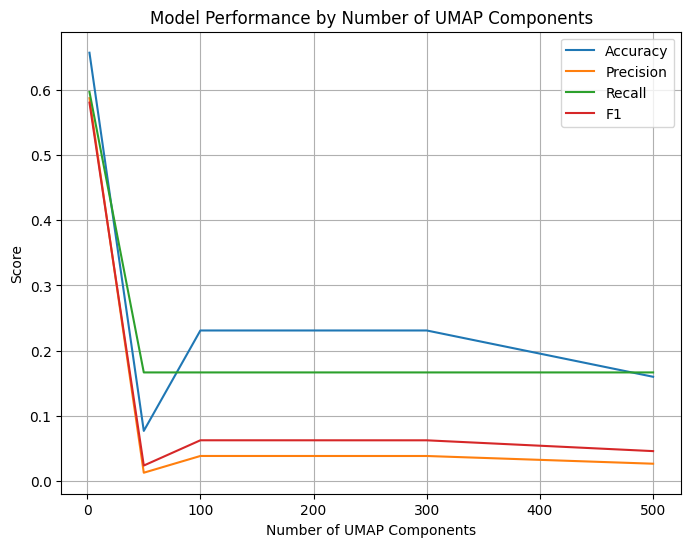

In [5]:
metric='cosine'
n_neighbors=20
min_dist=0.7

# Range of UMAP components to explore
components_range = [2, 50, 100, 300, 500]
n_epochs=200

metrics_results = {'accuracy': [], 'precision': [], 'recall': [], 'f1': []}

for n_components in components_range:
    # Preprocess features
    reducer = UMAP(n_components=n_components, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
    processed_features = reducer.fit_transform(data_x_cpu)
    data.x = torch.tensor(processed_features, dtype=torch.float)
    data = data.to(device)
    
    model = GCN_with_dropout(input_dim=n_components, hidden_dim=64, output_dim=dataset.num_classes, dropout_rate=0.9).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

    train_loop(n_epochs, model, optimizer, data, acc_freq=-1)
    accuracy, precision, recall, f1 = evaluate_model(model, data)
          
    metrics_results['accuracy'].append(accuracy)
    metrics_results['precision'].append(precision)
    metrics_results['recall'].append(recall)
    metrics_results['f1'].append(f1)

plt.figure(figsize=(8, 6))

for metric in metrics_results:
    plt.plot(components_range, metrics_results[metric], label=metric.capitalize())

plt.xlabel('Number of UMAP Components')
plt.ylabel('Score')
plt.title('Model Performance by Number of UMAP Components')
plt.legend()
plt.grid(True)
plt.show()


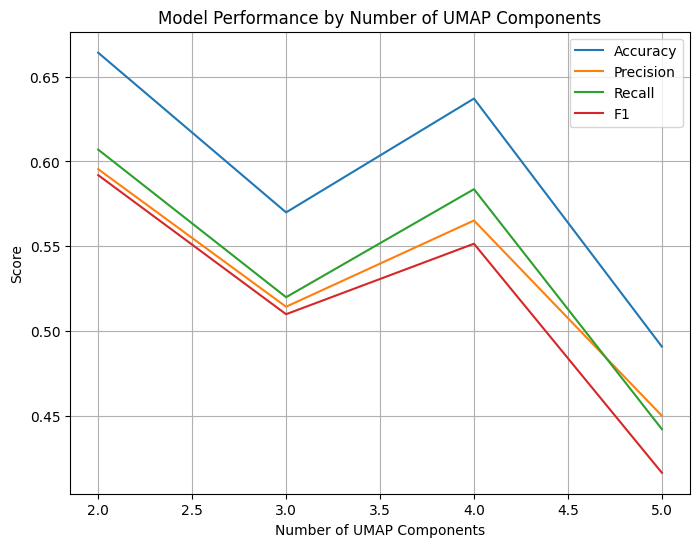

In [6]:
metric='cosine'
n_neighbors=20
min_dist=0.7


# Range of UMAP components to explore
components_range = [2, 3, 4, 5]
n_epochs=200

metrics_results = {'accuracy': [], 'precision': [], 'recall': [], 'f1': []}

for n_components in components_range:
    # Preprocess features
    reducer = UMAP(n_components=n_components, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
    processed_features = reducer.fit_transform(data_x_cpu)
    data.x = torch.tensor(processed_features, dtype=torch.float)
    data = data.to(device)
    
    model = GCN_with_dropout(input_dim=n_components, hidden_dim=64, output_dim=dataset.num_classes, dropout_rate=0.9).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

    train_loop(n_epochs, model, optimizer, data, acc_freq=-1)
    accuracy, precision, recall, f1 = evaluate_model(model, data)
          
    metrics_results['accuracy'].append(accuracy)
    metrics_results['precision'].append(precision)
    metrics_results['recall'].append(recall)
    metrics_results['f1'].append(f1)

plt.figure(figsize=(8, 6))

for metric in metrics_results:
    plt.plot(components_range, metrics_results[metric], label=metric.capitalize())

plt.xlabel('Number of UMAP Components')
plt.ylabel('Score')
plt.title('Model Performance by Number of UMAP Components')
plt.legend()
plt.grid(True)
plt.show()

### 3.5 Conclusions
The use of default UMAP as a preprocessing step before training GNN model did not yield the expected improvements and instead resulted in poor performance across various metrics, with accuracy around the 0.2 level.

Fine-tned UMAP however performed significantly better - especially for n_components=2. However, every metric (except accuracy) fell down by ~5 % points which is important when target accuracy is around 65-67%.


## 4. UMAP on original features

### 4.1 Default umap

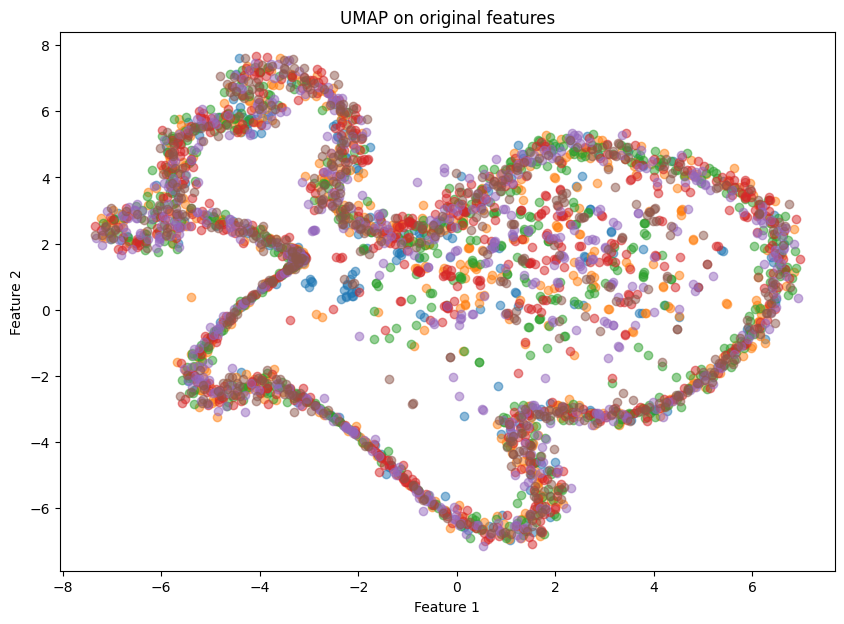

In [17]:
umap_post = UMAP(n_components=2, random_state=0)
embeddings_umap_post = umap_post.fit_transform(data_x_cpu)

visualise(embeddings_umap_post, data_y_cpu, 'UMAP on original features')

### 4.2 Fine-tuning umap

#### 4.2.1 metric vs min_dist vs n_neighbors

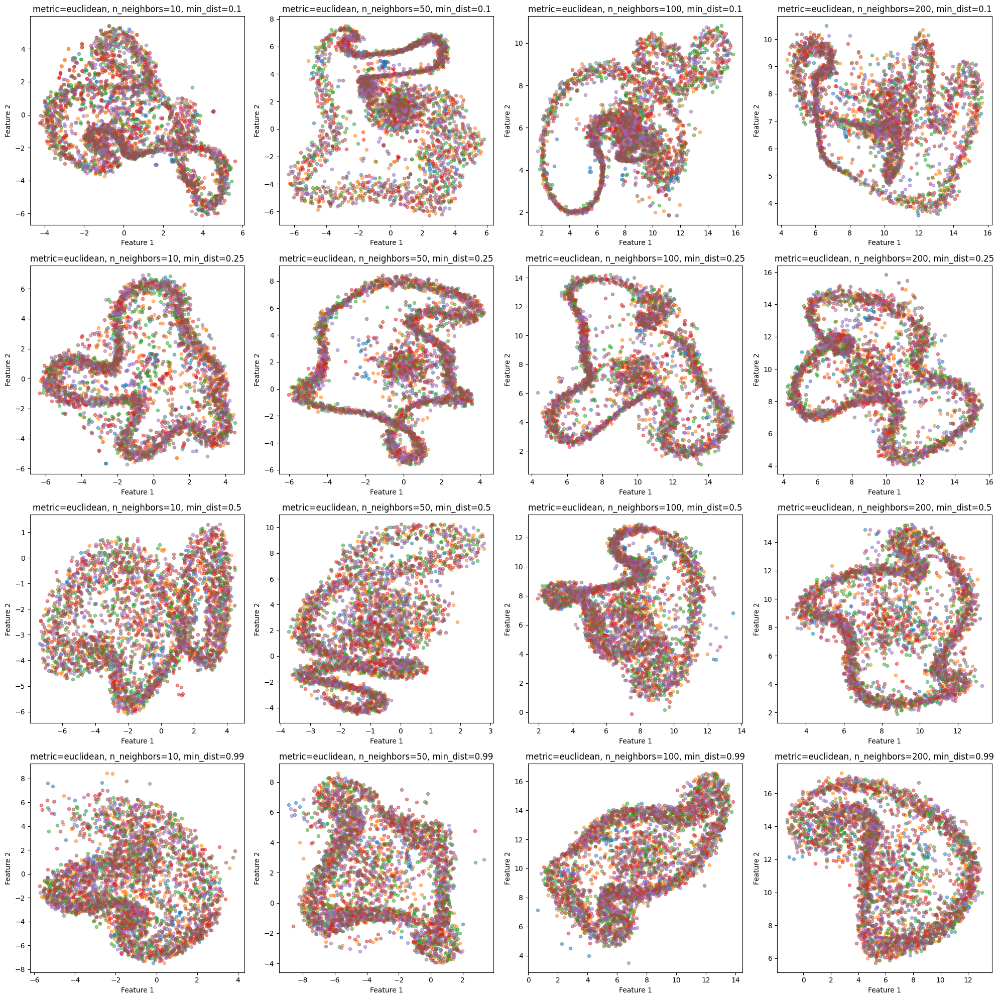

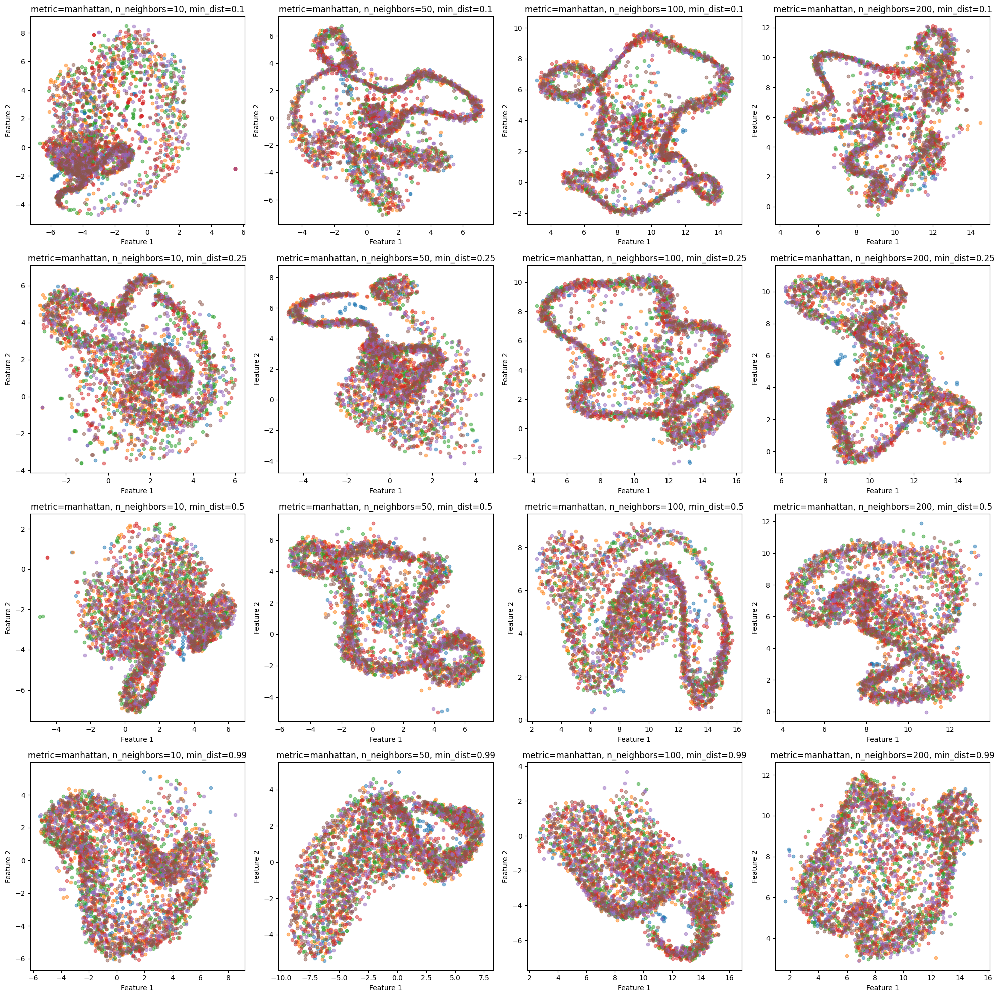

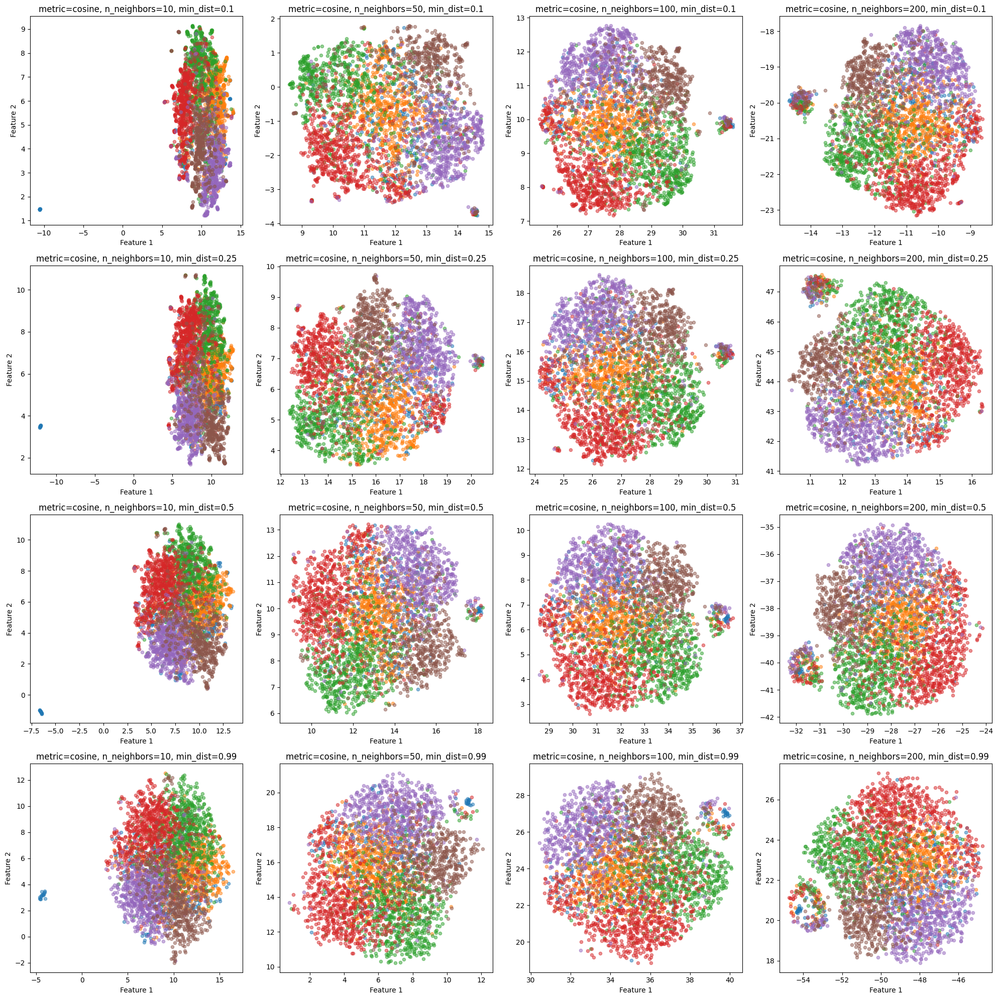

In [12]:
for metric in ['euclidean', 'manhattan', 'cosine']:
    fig, axs = plt.subplots(4, 4, figsize=(20, 20)) 
    axs = axs.flatten()
    i = 0
    for min_dist in [0.1, 0.25, 0.5, 0.99]:
        for n_neighbors in [10, 50, 100, 200]:
        
            umap_post = UMAP(n_components=2, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
            umap_results = umap_post.fit_transform(data_x_cpu)
    
            plot_no_show(axs[i], umap_results, data_y_cpu, f'metric={metric}, n_neighbors={n_neighbors}, min_dist={min_dist}', size=20)

            i += 1


    plt.tight_layout()
    plt.show()

The best metric is cosine. Min_dist=0.99 seems is beneficial, but let's investiagate further range of this parameter with greater frequency.

#### 4.2.2  n_neighbors and min_dist impact investigation

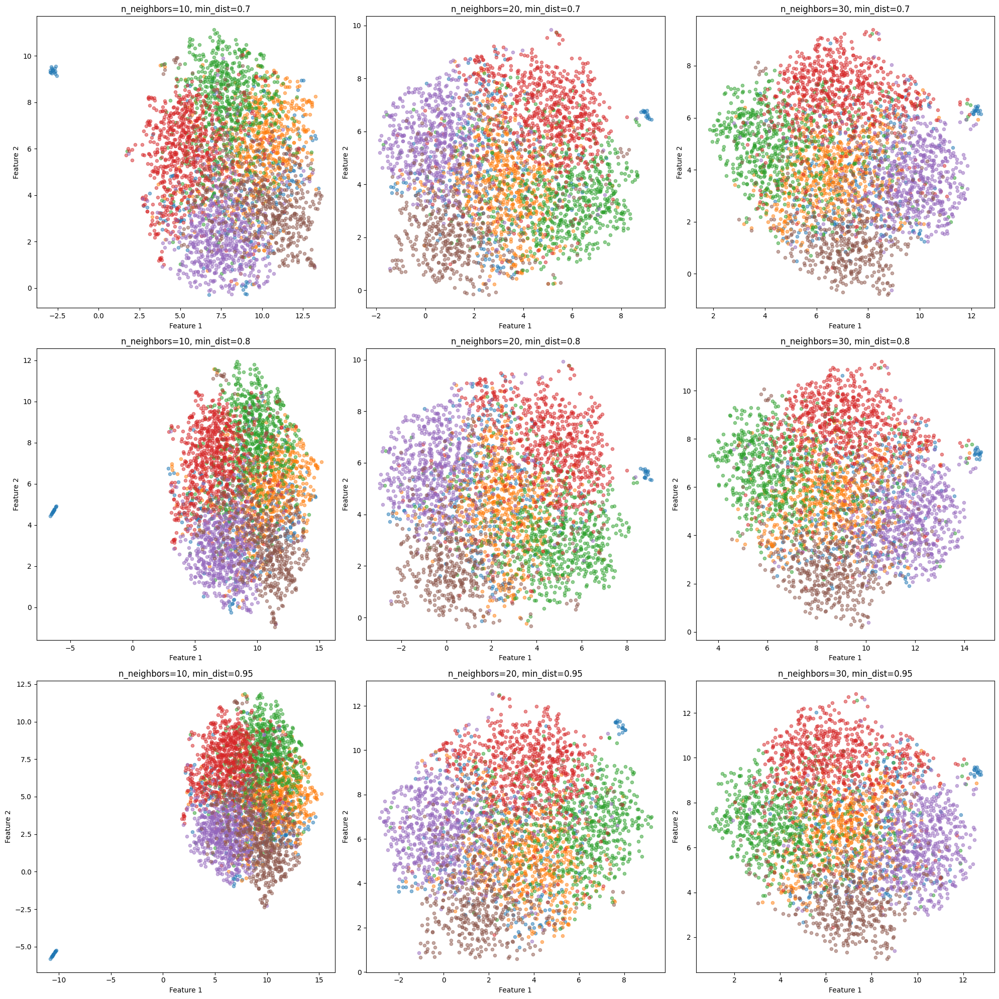

In [14]:
metric = 'cosine'
fig, axs = plt.subplots(3, 3, figsize=(20, 20)) 
axs = axs.flatten()
i = 0
for min_dist in [0.7, 0.8, 0.95]:
    for n_neighbors in [10, 20, 30]:
    
        umap_post = UMAP(n_components=2, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
        umap_results = umap_post.fit_transform(data_x_cpu)

        plot_no_show(axs[i], umap_results, data_y_cpu, f'n_neighbors={n_neighbors}, min_dist={min_dist}', size=20)

        i += 1


plt.tight_layout()
plt.show()

**n_neighbors=20** and **min_dist=0.7** proved to be the best parameters.

### 4.3 Fine-tuned UMAP vs default UMAP

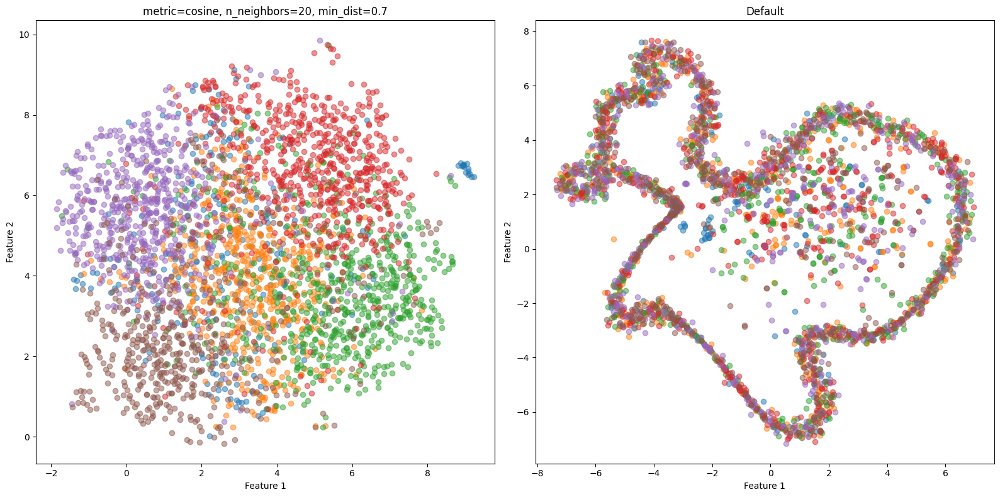

In [15]:
fig, axs = plt.subplots(1, 2, figsize=(16, 8)) 

metric='cosine'
n_neighbors=20
min_dist=0.7

umap_post = UMAP(n_components=2, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
umap_results = umap_post.fit_transform(data_x_cpu)

plot_no_show(axs[0], umap_results, data_y_cpu, f'metric={metric}, n_neighbors={n_neighbors}, min_dist={min_dist}')

umap_post = UMAP(n_components=2, random_state=0)
umap_results = umap_post.fit_transform(data_x_cpu)

plot_no_show(axs[1], umap_results, data_y_cpu, f'Default')

plt.tight_layout()
plt.show()

### 4.4 Accuracy-oriented fine-tuning UMAP

In [7]:
metric = 'cosine'

for min_dist in [0.7, 0.8, 0.95]:
    for n_neighbors in [10, 20, 30]:
    
        reducer = UMAP(n_components=2, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
        processed_features = reducer.fit_transform(data_x_cpu)

        print(f'\nn_neighbors={n_neighbors}, min_dist={min_dist}')

        data.x = torch.tensor(processed_features, dtype=torch.float)
        data = data.to(device)
        
        model = GCN_with_dropout(input_dim=2, hidden_dim=64, output_dim=dataset.num_classes, dropout_rate=0.9).to(device)
        optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
    
        train_loop(n_epochs, model, optimizer, data, acc_freq=-1)
         
        accuracy, precision, recall, f1 = evaluate_model(model, data)
        print(f"Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")


n_neighbors=10, min_dist=0.7
Accuracy: 0.4940, Precision: 0.4365, Recall: 0.4532, F1 Score: 0.4206

n_neighbors=20, min_dist=0.7
Accuracy: 0.6620, Precision: 0.5980, Recall: 0.6064, F1 Score: 0.5957

n_neighbors=30, min_dist=0.7
Accuracy: 0.6370, Precision: 0.5929, Recall: 0.5909, F1 Score: 0.5871

n_neighbors=10, min_dist=0.8
Accuracy: 0.5480, Precision: 0.5204, Recall: 0.5055, F1 Score: 0.4919

n_neighbors=20, min_dist=0.8
Accuracy: 0.6600, Precision: 0.5889, Recall: 0.6002, F1 Score: 0.5882

n_neighbors=30, min_dist=0.8
Accuracy: 0.5210, Precision: 0.5349, Recall: 0.5008, F1 Score: 0.4600

n_neighbors=10, min_dist=0.95
Accuracy: 0.6020, Precision: 0.5365, Recall: 0.5389, F1 Score: 0.5279

n_neighbors=20, min_dist=0.95
Accuracy: 0.6310, Precision: 0.5566, Recall: 0.5741, F1 Score: 0.5503

n_neighbors=30, min_dist=0.95
Accuracy: 0.6170, Precision: 0.5759, Recall: 0.5760, F1 Score: 0.5699


<Figure size 640x480 with 0 Axes>

## 5. UMAP on original features vs learned representations

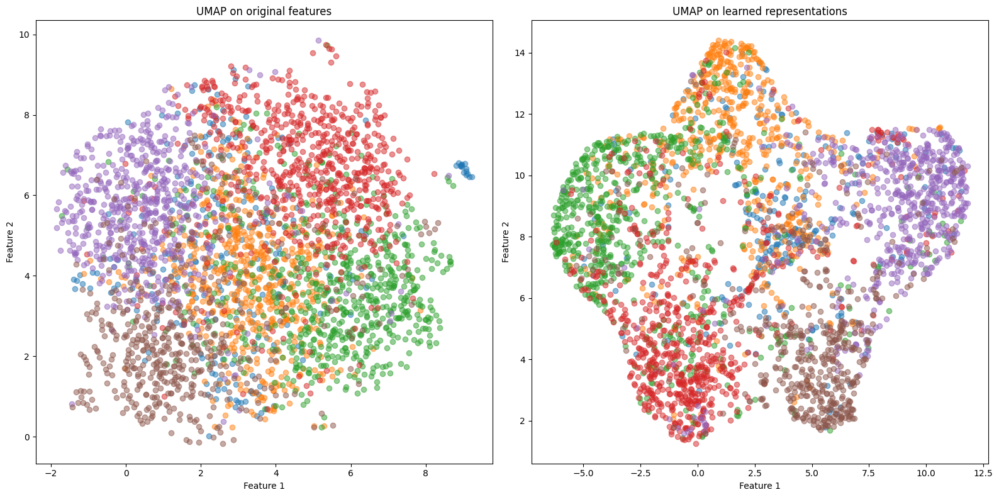

In [24]:
fig, axs = plt.subplots(1, 2, figsize=(16, 8)) 

metric='cosine'
n_neighbors=20
min_dist=0.7

umap_post = UMAP(n_components=2, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
umap_results = umap_post.fit_transform(data_x_cpu)

plot_no_show(axs[0], umap_results, data_y_cpu, f'UMAP on original features')

metric='cosine'
n_neighbors=50
min_dist=0.5

umap_post = UMAP(n_components=2, random_state=0, n_neighbors=n_neighbors, min_dist=min_dist, metric=metric)
umap_results = umap_post.fit_transform(embeddings)

plot_no_show(axs[1], umap_results, data_y_cpu, f'UMAP on learned representations')

plt.tight_layout()
plt.show()

## 6. Final conclusions
**UMAP AS POSTPROCESSING STEP**

**Left plot: UMAP on original features**
- Feature overlap: There is a notable overlap among different classes, as indicated by the mingling of colors. This suggests that the original high-dimensional space does not easily allow for class separation.
- Global structure: UMAP has a tendency to maintain more of the global structure of the data compared to t-SNE, and this plot does show some broad groupings. However, the boundaries are not well-defined, which could imply that the original features alone may not be optimal for tasks that rely on clear class discrimination.


**Right plot: UMAP on learned representations**
- Improved clustering: The plot representing UMAP on the GNN's learned representations exhibits better clustering of similar data points (nodes). The colors representing different classes are more segregated into distinct clusters than in the original feature space.
- Class separation: The separation between clusters indicates that the GNN model is producing embeddings that encapsulate the structural and feature-related properties of the graph more effectively than the original features alone.
- Data manifold: The shape of the data distribution suggests that UMAP has captured a complex manifold where the GNN's learned representations reside. It indicates that the GNN has learned embeddings that reflect underlying data patterns conducive to node classification.


**UMAP AS PREPROCESSING STEP**
- UMAP applied as preprocessing step proved to be very fragile to fine-tuning.
- Default UMAP configuration performed very poorly, not exceeding 0.3 accuracy or other metrics values.
- Fine-tuned UMAP performed much better although the metrics still fell down by 5%.